# 1. Вебинар по RL

Попробуем применить RL в рамках задачи с шахматами


## Определение RL

Обучение с подкреплением (Reinforcement Learning, RL) — это метод машинного обучения, в котором агент учится, взаимодействуя со средой, чтобы максимизировать некую кумулятивную награду.

В отличие от обучения с учителем, где у нас есть явные пары "входные данные - правильный ответ", в RL у нас нет прямых указаний о том, какое действие лучше всего выполнить в каждом конкретном случае. Агенту приходится опираться на обратную связь в виде награды, чтобы узнать, правильно ли он действовал.

## Основные компоненты RL

* Инициализация: Агент начинает в каком-то начальном состоянии и не имеет представления о среде.
* Выбор действия: Агент выбирает действие на основе текущего состояния.
* Взаимодействие: Среда реагирует на действие агента и возвращает новое состояние и награду.
* Обучение: Агент обновляет свои знания на основе полученной награды.
* Повтор: Процесс повторяется до достижения конечного состояния или заданного числа шагов.


В RL агент постоянно исследует среду, выбирая действия, которые максимизируют его кумулятивную награду. Это делает RL особенно привлекательным для задач, где правильное решение не явно задано или известно.



## 2. Библиотека python-chess

In [ ]:
# Для начала установим библиотеку python-chess:
!pip install python-chess

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 154.4/154.4 kB 3.2 MB/s eta 0:00:00


In [ ]:
import chess

## Базовые операции с библиотекой


Доска шахмат создается очень просто:

In [ ]:
board = chess.Board()
print(board)

r n b q k b n r
p p p p p p p p
. . . . . . . .
. . . . . . . .
. . . . . . . .
. . . . . . . .
P P P P P P P P
R N B Q K B N R


**Совершение ходов**

В python-chess есть несколько способов представления и выполнения ходов:

1) **Стандартная алгебраическая нотация (SAN)**

**Что это?**

Это традиционный способ записи шахматных ходов, который часто используется в книгах и обучающих материалах. Например, когда ферзь двигается на клетку d4, записывают Qd4.

**Примеры:**

e4: Пешка передвигается на клетку e4.

Nf3: Конь (обозначается буквой N на английском) передвигается на клетку f3.

exd5: Пешка с клетки e "бьет" или "занимает" клетку d5.

**Применение в коде:**

In [ ]:
move = board.parse_san("e4")  # Преобразование нотации в ход
board.push(move)  # Совершение хода на доске

In [ ]:
print(board)

r n b q k b n r
p p p p p p p p
. . . . . . . .
. . . . . . . .
. . . . P . . .
. . . . . . . .
P P P P . P P P
R N B Q K B N R


**2) Универсальная шахматная нотация (UCI)**

**Что это?**

Это более "технический" формат записи, который часто используется компьютерными программами и движками. Ход описывается начальной и конечной позицией без учета типа фигуры.

**Примеры:**

e2e4: Пешка передвигается с клетки e2 на e4.
g1f3: Фигура (в данном случае конь) двигается с g1 на f3.

**Применение в коде:**

In [ ]:
move = chess.Move.from_uci("e2e4")  # Преобразование нотации в ход
board.push(move)  # Совершение хода на доске

**3) Создание хода напрямую**

**Что это?**

Это метод, где вы явно указываете начальную и конечную позицию хода. В python-chess каждая клетка имеет свой уникальный идентификатор.

**Пример:**

Для передвижения пешки с клетки e2 на e4, вы должны указать идентификаторы этих клеток.

**Применение в коде:**

In [ ]:
move = chess.Move(chess.E2, chess.E4)  # Создание хода по начальной и конечной клетке
board.push(move)  # Совершение хода на доске

Проверка конца игры

Мы можем проверить, окончена ли игра:

In [ ]:
board.is_game_over()
# Этот метод вернет True, если игра закончена (мат, пат или другая причина), и False в противном случае.

False

Для более красивой визуализации в Colab мы можем использовать chess.svg:

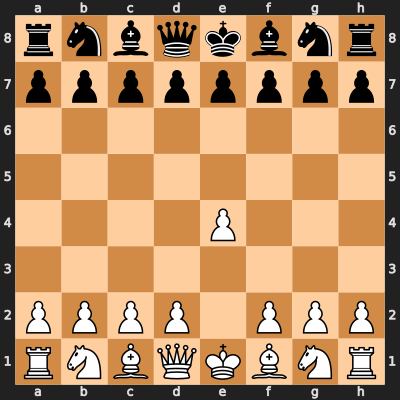

In [ ]:
from IPython.display import display, SVG
import chess.svg
# Отображение доски
display(SVG(chess.svg.board(board=board, size=400)))

Получение возможных ходов

Для получения списка всех возможных ходов в текущем состоянии:

In [ ]:
moves = list(board.legal_moves)
print(moves)

[Move.from_uci('g8h6'), Move.from_uci('g8f6'), Move.from_uci('b8c6'), Move.from_uci('b8a6'), Move.from_uci('h7h6'), Move.from_uci('g7g6'), Move.from_uci('f7f6'), Move.from_uci('e7e6'), Move.from_uci('d7d6'), Move.from_uci('c7c6'), Move.from_uci('b7b6'), Move.from_uci('a7a6'), Move.from_uci('h7h5'), Move.from_uci('g7g5'), Move.from_uci('f7f5'), Move.from_uci('e7e5'), Move.from_uci('d7d5'), Move.from_uci('c7c5'), Move.from_uci('b7b5'), Move.from_uci('a7a5')]


Отмена последнего хода

Если вы хотите отменить последний ход:

In [ ]:
board.pop()

Move.from_uci('e2e4')

## 3. Преобразование шахматной игры в задачу RL

Чтобы применить обучение с подкреплением к игре в шахматы, нам необходимо правильно определить основные компоненты RL в контексте шахматной игры.

### Состояние

**Определение**: В RL состояние представляет текущее положение агента в среде.

В контексте шахмат состоянием является текущее расположение всех фигур на доске.

Мы можем представить состояние доски в виде строки FEN (Forsyth-Edwards Notation):

FEN (Forsyth-Edwards Notation) — это стандартная нотация, используемая для представления позиции на шахматной доске. С её помощью можно быстро и точно передать расположение фигур на доске, а также другую информацию о текущем состоянии игры, такую как право на рокировку, возможность взятия на проходе и количество ходов без передвижения пешек или взятия фигур.

Строка FEN состоит из нескольких полей, разделенных пробелами:

Позиция фигур: Отображает расположение фигур на доске, начиная с 8-й горизонтали и двигаясь к 1-й. Пустые клетки представлены числами от 1 до 8. Фигуры обозначаются следующими символами:

Белые фигуры: P (пешка), N (конь), B (слон), R (ладья), Q (ферзь), K (король).
Черные фигуры: p, n, b, r, q, k.
Например, начальная позиция представляется как: rnbqkbnr/pppppppp/8/8/8/8/PPPPPPPP/RNBQKBNR

Ходящая сторона: Одним символом обозначается, кто ходит следующим - белые (w) или черные (b).

Право на рокировку: Обозначает возможность рокировки для каждой стороны.

K означает, что у белых есть право на короткую рокировку.
Q — на длинную рокировку.
k и q — аналогичные права для черных.
Если рокировка невозможна для обеих сторон, ставится -.
Взятие на проходе: Если последний ход был двойным ходом пешки, поле, на которое можно взять эту пешку "на проходе", указывается здесь. Если взятия на проходе нет, ставится -.

Полусуточный счетчик: Считает количество ходов (полуходов) с момента последнего движения пешки или взятия фигуры. Используется для правила 50 ходов, по которому игра может быть объявлена ничьей, если 50 ходов подряд не было сделано ни одного хода пешкой и не было взято ни одной фигуры.

Счетчик ходов: Считает количество полных ходов. Начинается с 1, и увеличивается после каждого хода черных.

Пример строки FEN для начальной позиции на шахматной доске:

rnbqkbnr/pppppppp/8/8/8/8/PPPPPPPP/RNBQKBNR w KQkq - 0 1

Эта нотация чрезвычайно полезна для быстрой установки специфических позиций на доске или для сохранения и загрузки партий.


In [ ]:
fen_state = board.fen()
print(fen_state)

rnbqkbnr/pppppppp/8/8/4P3/8/PPPP1PPP/RNBQKBNR b KQkq - 0 2


### Действие

**Определение**: Действие - это то, что агент может предпринять в данном состоянии среды.

В шахматах действиями являются все возможные ходы, которые игрок может сделать из текущего состояния.

In [ ]:
possible_moves = list(board.legal_moves)
possible_moves

[Move.from_uci('g8h6'),
 Move.from_uci('g8f6'),
 Move.from_uci('b8c6'),
 Move.from_uci('b8a6'),
 Move.from_uci('h7h6'),
 Move.from_uci('g7g6'),
 Move.from_uci('f7f6'),
 Move.from_uci('e7e6'),
 Move.from_uci('d7d6'),
 Move.from_uci('c7c6'),
 Move.from_uci('b7b6'),
 Move.from_uci('a7a6'),
 Move.from_uci('h7h5'),
 Move.from_uci('g7g5'),
 Move.from_uci('f7f5'),
 Move.from_uci('e7e5'),
 Move.from_uci('d7d5'),
 Move.from_uci('c7c5'),
 Move.from_uci('b7b5'),
 Move.from_uci('a7a5')]

### Награда

**Определение**: Награда — это численное значение, которое среда возвращает агенту после каждого действия.

В шахматах награда может зависеть от многих факторов. Простая модель награды может выглядеть так:

*   +1 за поимку фигуры противника.
*   -1 за потерю своей фигуры.
*   +10 за поставленный мат противнику.
*   -10 за мат от противника.
*   0 за все другие ходы.

Однако это очень упрощенная модель, и в реальных условиях вы, возможно, захотите использовать более сложные и тонко настроенные системы наград.

### Реализация RL-агента

Для простоты давайте рассмотрим агента, который в начале выбирает ходы случайно. Это будет наша исходная точка, от которой мы будем исходить при дальнейшем обучении.

In [ ]:
import random

def choose_move(board):
    return random.choice(list(board.legal_moves))

##  4. Создание простого RL-агента
### Базовая структура агента

Прежде чем внедрять алгоритмы RL, начнем с базовой структуры агента:

In [ ]:
class ChessAgent:
    def __init__(self):
        pass

    def choose_move(self, board):
        raise NotImplementedError

    def receive_reward(self, reward):
        raise NotImplementedError

    def game_over(self):
        raise NotImplementedError

### Простейший случайный агент

Прежде чем перейти к сложному RL, создадим агента, который просто выбирает ход случайным образом:

In [ ]:
class RandomChessAgent(ChessAgent):
    def choose_move(self, board):
        return random.choice(list(board.legal_moves))

    def receive_reward(self, reward):
        pass  # На данный момент он не делает ничего с полученной наградой

    def game_over(self):
        pass  # Может быть использовано для сброса внутреннего состояния или статистики

### Взаимодействие с окружением и обучение

Для начала определим функцию, которая определяет награду на основе событий игры:

In [ ]:
def determine_reward(board):
    if board.is_checkmate():
        if board.turn == chess.WHITE:
            return -10  # Мат черным
        else:
            return 10   # Мат белым
    elif board.is_stalemate() or board.is_insufficient_material():
        return 0
    else:
        # Можно расширить для других событий, например, +1 за поимку фигуры противника и т.д.
        return 0

Теперь создадим функцию, которая позволяет агенту играть:

In [ ]:
def play_game(agent):
    board = chess.Board()
    while not board.is_game_over():
        move = agent.choose_move(board)
        board.push(move)

        reward = determine_reward(board)
        agent.receive_reward(reward)

    agent.game_over()

### Визуализация игры и статистика

In [ ]:
def play_game(agent, display_svg=True, show_logs=True):
    board = chess.Board()
    move_counter = 0

    while not board.is_game_over():
        move = agent.choose_move(board)
        board.push(move)

        move_counter += 1

        if display_svg:
            print(f"Ход {move_counter}:")
            #print(board)
            #print("\n" + "-"*40 + "\n")
            display(SVG(chess.svg.board(board=board, size=100)))

        reward = determine_reward(board)
        agent.receive_reward(reward)

    agent.game_over()

    # Краткая статистика
    if show_logs:
        print("Игра завершилась!")
        if board.is_checkmate():
            print("Результат: мат!")
        elif board.is_stalemate():
            print("Результат: пат!")
        elif board.is_insufficient_material():
            print("Результат: недостаточно материала для мата!")
        else:
            print("Результат: другая ничья!")

        print(f"Всего ходов: {move_counter}")


### Запуск и тестирование

Теперь мы можем запустить и протестировать нашего случайного агента:


Ход 1:


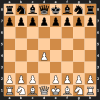

Ход 2:


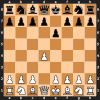

Ход 3:


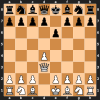

Ход 4:


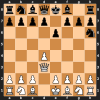

Ход 5:


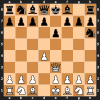

Ход 6:


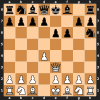

Ход 7:


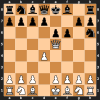

Ход 8:


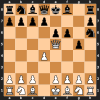

Ход 9:


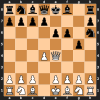

Ход 10:


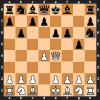

Ход 11:


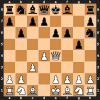

Ход 12:


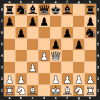

Ход 13:


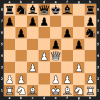

Ход 14:


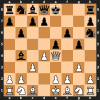

Ход 15:


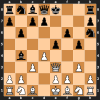

Ход 16:


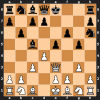

Ход 17:


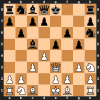

Ход 18:


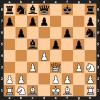

Ход 19:


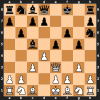

Ход 20:


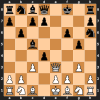

Ход 21:


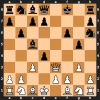

Ход 22:


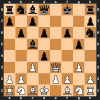

Ход 23:


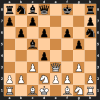

Ход 24:


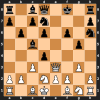

Ход 25:


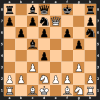

Ход 26:


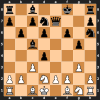

Ход 27:


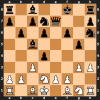

Ход 28:


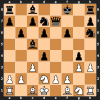

Ход 29:


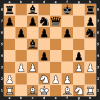

Ход 30:


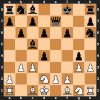

Ход 31:


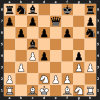

Ход 32:


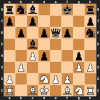

Ход 33:


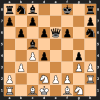

Ход 34:


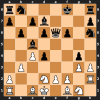

Ход 35:


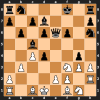

Ход 36:


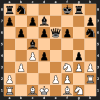

Ход 37:


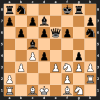

Ход 38:


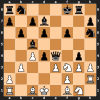

Ход 39:


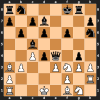

Ход 40:


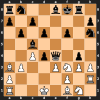

Ход 41:


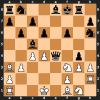

Ход 42:


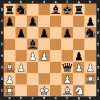

Ход 43:


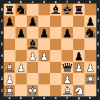

Ход 44:


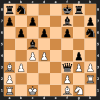

Ход 45:


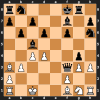

Ход 46:


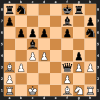

Ход 47:


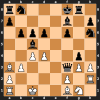

Ход 48:


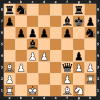

Ход 49:


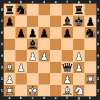

Ход 50:


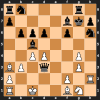

Ход 51:


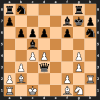

Ход 52:


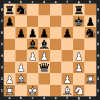

Ход 53:


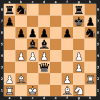

Ход 54:


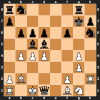

Ход 55:


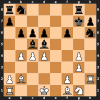

Ход 56:


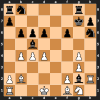

Ход 57:


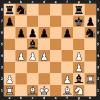

Ход 58:


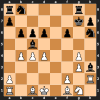

Ход 59:


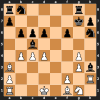

Ход 60:


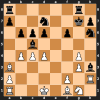

Ход 61:


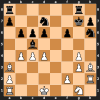

Ход 62:


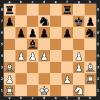

Ход 63:


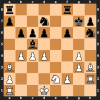

Ход 64:


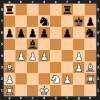

Ход 65:


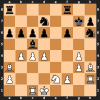

Ход 66:


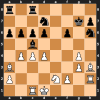

Ход 67:


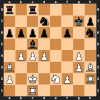

Ход 68:


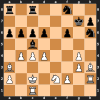

Ход 69:


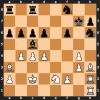

Ход 70:


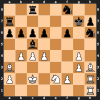

Ход 71:


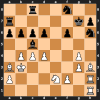

Ход 72:


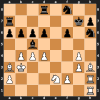

Ход 73:


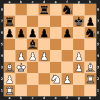

Ход 74:


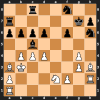

Ход 75:


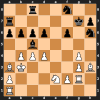

Ход 76:


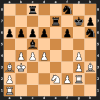

Ход 77:


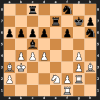

Ход 78:


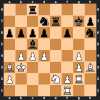

Ход 79:


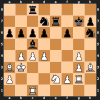

Ход 80:


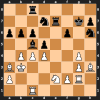

Ход 81:


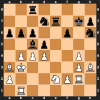

Ход 82:


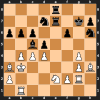

Ход 83:


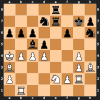

Ход 84:


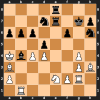

Ход 85:


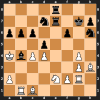

Ход 86:


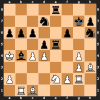

Ход 87:


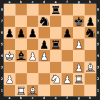

Ход 88:


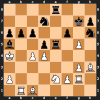

Ход 89:


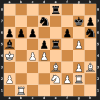

Ход 90:


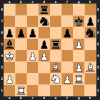

Ход 91:


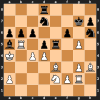

Ход 92:


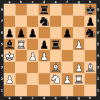

Ход 93:


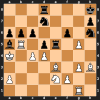

Ход 94:


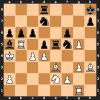

Ход 95:


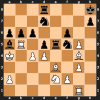

Ход 96:


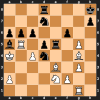

Ход 97:


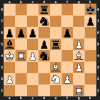

Ход 98:


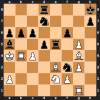

Ход 99:


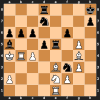

Ход 100:


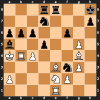

Ход 101:


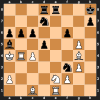

Ход 102:


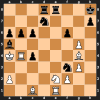

Ход 103:


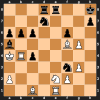

Ход 104:


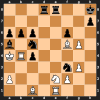

Ход 105:


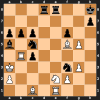

Ход 106:


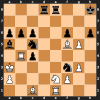

Ход 107:


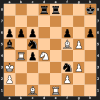

Ход 108:


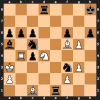

Ход 109:


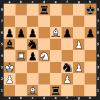

Ход 110:


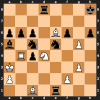

Ход 111:


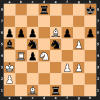

Ход 112:


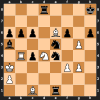

Ход 113:


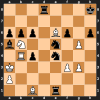

Ход 114:


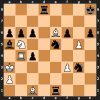

Ход 115:


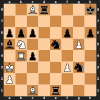

Ход 116:


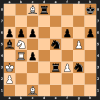

Ход 117:


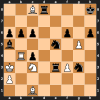

Ход 118:


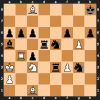

Ход 119:


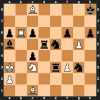

Ход 120:


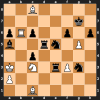

Ход 121:


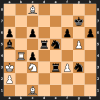

Ход 122:


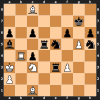

Ход 123:


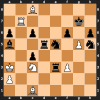

Ход 124:


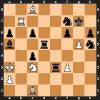

Ход 125:


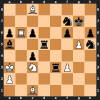

Ход 126:


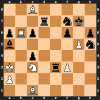

Ход 127:


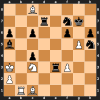

Ход 128:


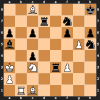

Ход 129:


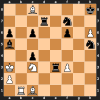

Ход 130:


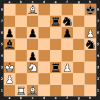

Ход 131:


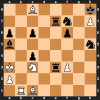

Ход 132:


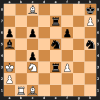

Ход 133:


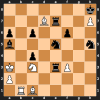

Ход 134:


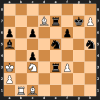

Ход 135:


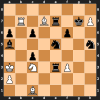

Ход 136:


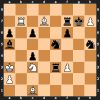

Ход 137:


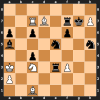

Ход 138:


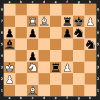

Ход 139:


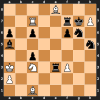

Ход 140:


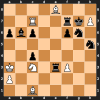

Ход 141:


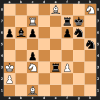

Ход 142:


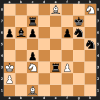

Ход 143:


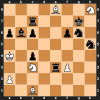

Ход 144:


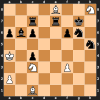

Ход 145:


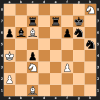

Ход 146:


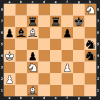

Ход 147:


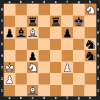

Ход 148:


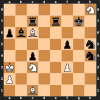

Ход 149:


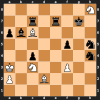

Ход 150:


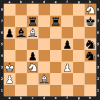

Ход 151:


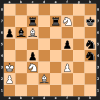

Ход 152:


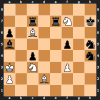

Ход 153:


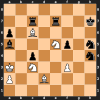

Ход 154:


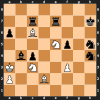

Ход 155:


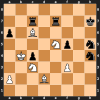

Ход 156:


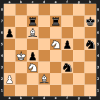

Ход 157:


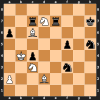

Ход 158:


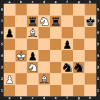

Ход 159:


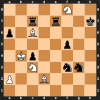

Ход 160:


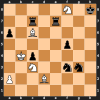

Ход 161:


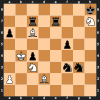

Ход 162:


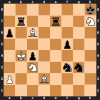

Ход 163:


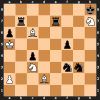

Ход 164:


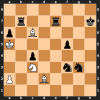

Ход 165:


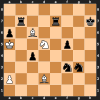

Ход 166:


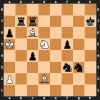

Ход 167:


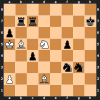

Ход 168:


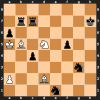

Ход 169:


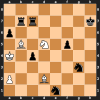

Ход 170:


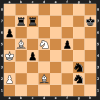

Ход 171:


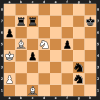

Ход 172:


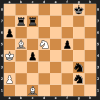

Ход 173:


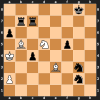

Ход 174:


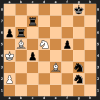

Ход 175:


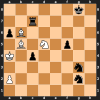

Ход 176:


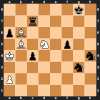

Ход 177:


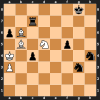

Ход 178:


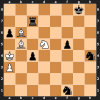

Ход 179:


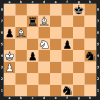

Ход 180:


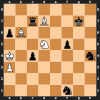

Ход 181:


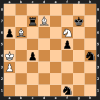

Ход 182:


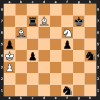

Ход 183:


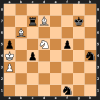

Ход 184:


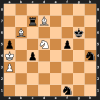

Ход 185:


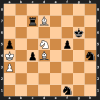

Ход 186:


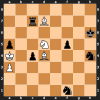

Ход 187:


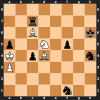

Ход 188:


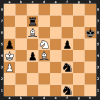

Ход 189:


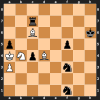

Ход 190:


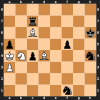

Ход 191:


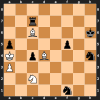

Ход 192:


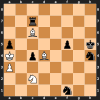

Ход 193:


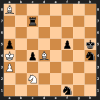

Ход 194:


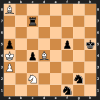

Ход 195:


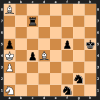

Ход 196:


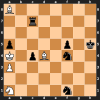

Ход 197:


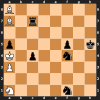

Ход 198:


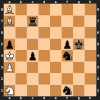

Ход 199:


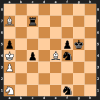

Ход 200:


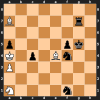

Ход 201:


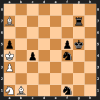

Ход 202:


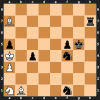

Ход 203:


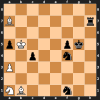

Ход 204:


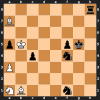

Ход 205:


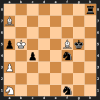

Ход 206:


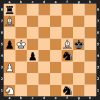

Ход 207:


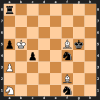

Ход 208:


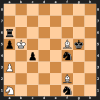

Ход 209:


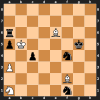

Ход 210:


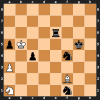

Ход 211:


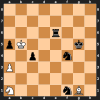

Ход 212:


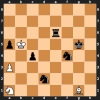

Ход 213:


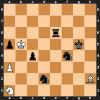

Ход 214:


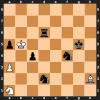

Ход 215:


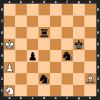

Ход 216:


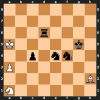

Ход 217:


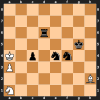

Ход 218:


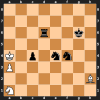

Ход 219:


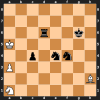

Ход 220:


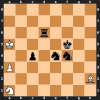

Ход 221:


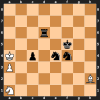

Ход 222:


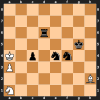

Ход 223:


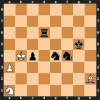

Ход 224:


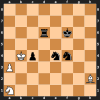

Ход 225:


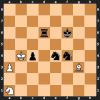

Ход 226:


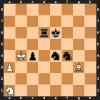

Ход 227:


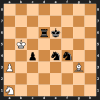

Ход 228:


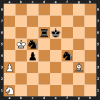

Ход 229:


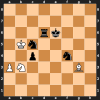

Ход 230:


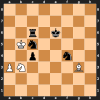

Ход 231:


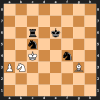

Ход 232:


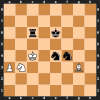

Ход 233:


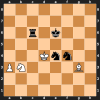

Ход 234:


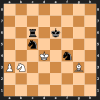

Ход 235:


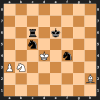

Ход 236:


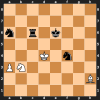

Ход 237:


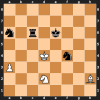

Ход 238:


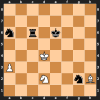

Ход 239:


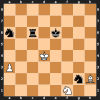

Ход 240:


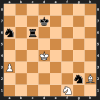

Ход 241:


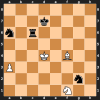

Ход 242:


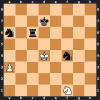

Ход 243:


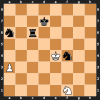

Ход 244:


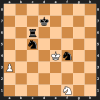

Ход 245:


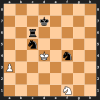

Ход 246:


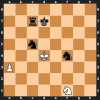

Ход 247:


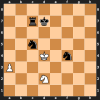

Ход 248:


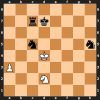

Ход 249:


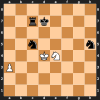

Ход 250:


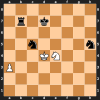

Ход 251:


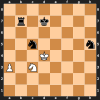

Ход 252:


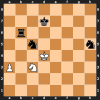

Ход 253:


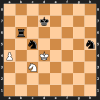

Ход 254:


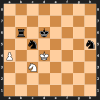

Ход 255:


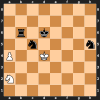

Ход 256:


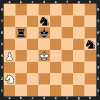

Ход 257:


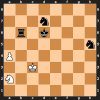

Ход 258:


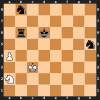

Ход 259:


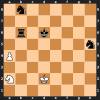

Ход 260:


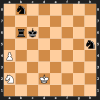

Ход 261:


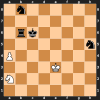

Ход 262:


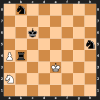

Ход 263:


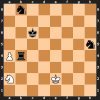

Ход 264:


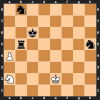

Ход 265:


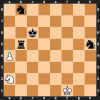

Ход 266:


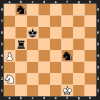

Ход 267:


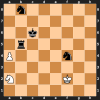

Ход 268:


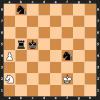

Ход 269:


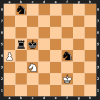

Ход 270:


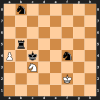

Ход 271:


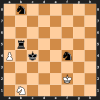

Ход 272:


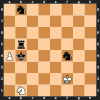

Ход 273:


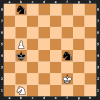

Ход 274:


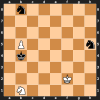

Ход 275:


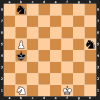

Ход 276:


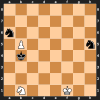

Ход 277:


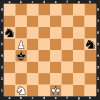

Ход 278:


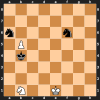

Ход 279:


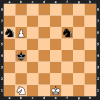

Ход 280:


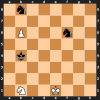

Ход 281:


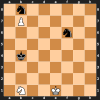

Ход 282:


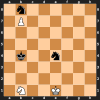

Ход 283:


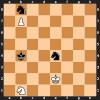

Ход 284:


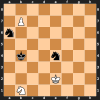

Ход 285:


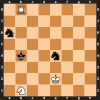

Ход 286:


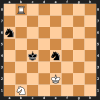

Ход 287:


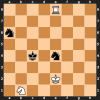

Ход 288:


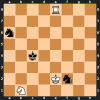

Ход 289:


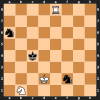

Ход 290:


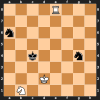

Ход 291:


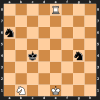

Ход 292:


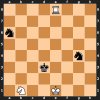

Ход 293:


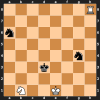

Ход 294:


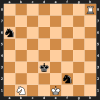

Ход 295:


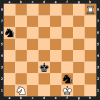

Ход 296:


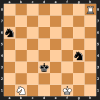

Ход 297:


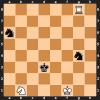

Ход 298:


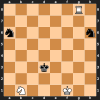

Ход 299:


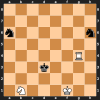

Ход 300:


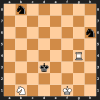

Ход 301:


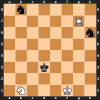

Ход 302:


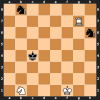

Ход 303:


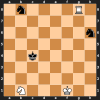

Ход 304:


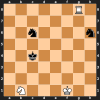

Ход 305:


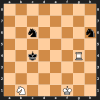

Ход 306:


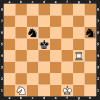

Ход 307:


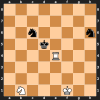

Ход 308:


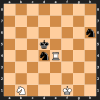

Ход 309:


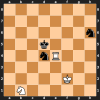

Ход 310:


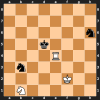

Ход 311:


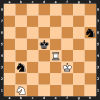

Ход 312:


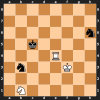

Ход 313:


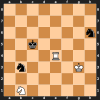

Ход 314:


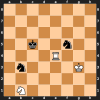

Ход 315:


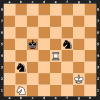

Ход 316:


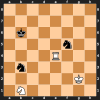

Ход 317:


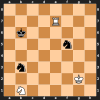

Ход 318:


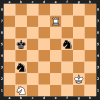

Ход 319:


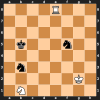

Ход 320:


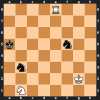

Ход 321:


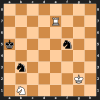

Ход 322:


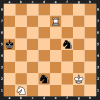

Ход 323:


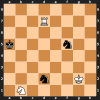

Ход 324:


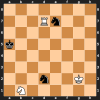

Ход 325:


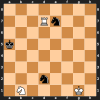

Ход 326:


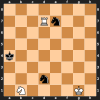

Ход 327:


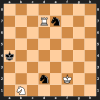

Ход 328:


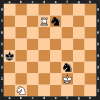

Ход 329:


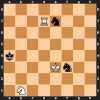

Ход 330:


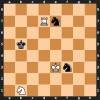

Ход 331:


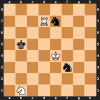

Ход 332:


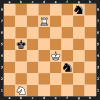

Ход 333:


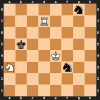

Ход 334:


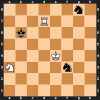

Ход 335:


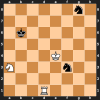

Ход 336:


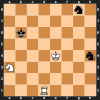

Ход 337:


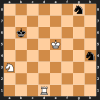

Ход 338:


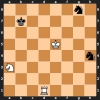

Ход 339:


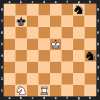

Ход 340:


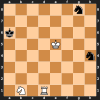

Ход 341:


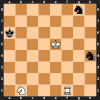

Ход 342:


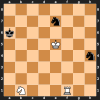

Ход 343:


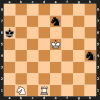

Ход 344:


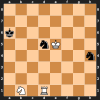

Ход 345:


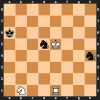

Ход 346:


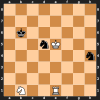

Ход 347:


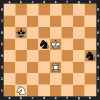

Ход 348:


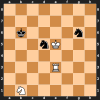

Ход 349:


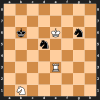

Ход 350:


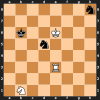

Ход 351:


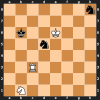

Ход 352:


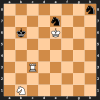

Ход 353:


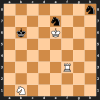

Ход 354:


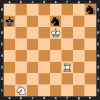

Ход 355:


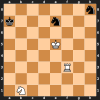

Ход 356:


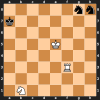

Ход 357:


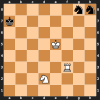

Ход 358:


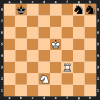

Ход 359:


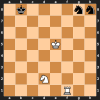

Ход 360:


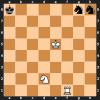

Ход 361:


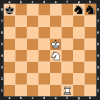

Ход 362:


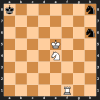

Ход 363:


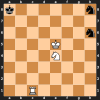

Ход 364:


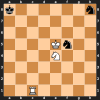

Ход 365:


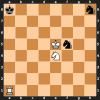

Ход 366:


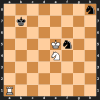

Ход 367:


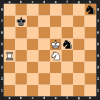

Ход 368:


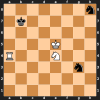

Ход 369:


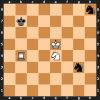

Ход 370:


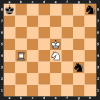

Ход 371:


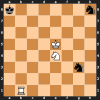

Ход 372:


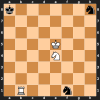

Ход 373:


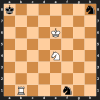

Ход 374:


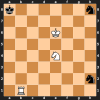

Ход 375:


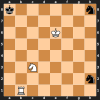

Ход 376:


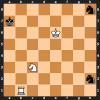

Ход 377:


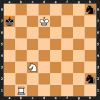

Ход 378:


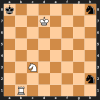

Ход 379:


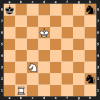

Ход 380:


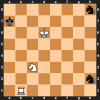

Ход 381:


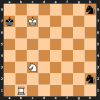

Ход 382:


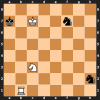

Ход 383:


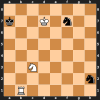

Ход 384:


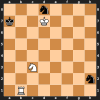

Ход 385:


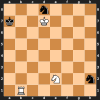

Ход 386:


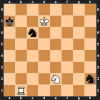

Ход 387:


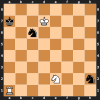

Ход 388:


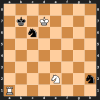

Ход 389:


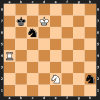

Ход 390:


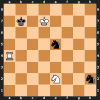

Ход 391:


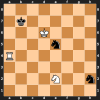

Ход 392:


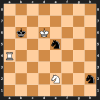

Ход 393:


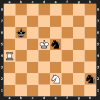

Ход 394:


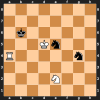

Ход 395:


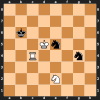

Ход 396:


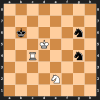

Ход 397:


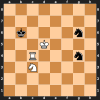

Ход 398:


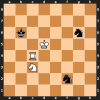

Ход 399:


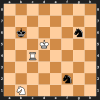

Ход 400:


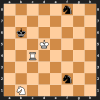

Ход 401:


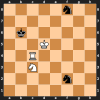

Ход 402:


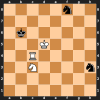

Ход 403:


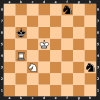

Ход 404:


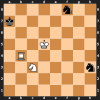

Ход 405:


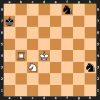

Ход 406:


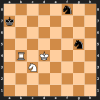

Ход 407:


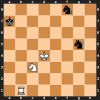

Ход 408:


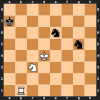

Ход 409:


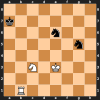

Ход 410:


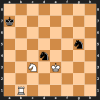

Ход 411:


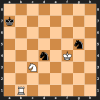

Ход 412:


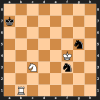

Ход 413:


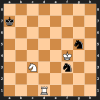

Ход 414:


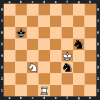

Ход 415:


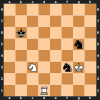

Ход 416:


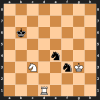

Ход 417:


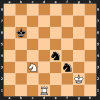

Ход 418:


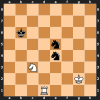

Ход 419:


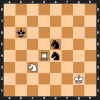

Ход 420:


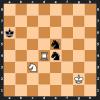

Ход 421:


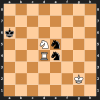

Ход 422:


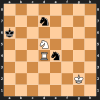

Ход 423:


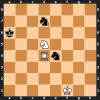

Ход 424:


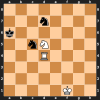

Ход 425:


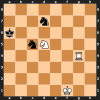

Ход 426:


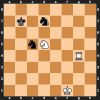

Ход 427:


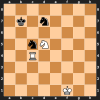

Ход 428:


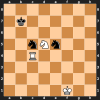

Ход 429:


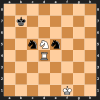

Ход 430:


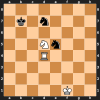

Ход 431:


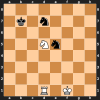

Ход 432:


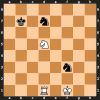

Ход 433:


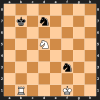

Ход 434:


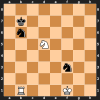

Ход 435:


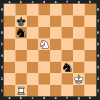

Игра завершилась!
Результат: другая ничья!
Всего ходов: 435


In [ ]:
agent = RandomChessAgent()
play_game(agent)

На этом этапе у вас есть простой шахматный агент, который делает случайные ходы. Этот агент служит основой для дальнейших улучшений и внедрения алгоритмов RL.

## 5. Обучение RL-агента играть в шахматы

Для простоты рассмотрим Q-обучение, один из наиболее популярных методов обучения с подкреплением.

### Кратко о Q-обучении
Q-обучение основано на идее оценки "качества" комбинации состояний и действий (Q-значение). Агент стремится узнать, какое действие приведет к наибольшей награде в каждом состоянии.

https://iq.opengenus.org/content/images/2019/09/1.gif

### Инициализация Q-таблицы

Из-за огромного числа возможных состояний в шахматах мы будем использовать упрощенную версию Q-таблицы, которая будет учитывать только последний ход и возможные ответы на него.

In [ ]:
import numpy as np

class QLearningChessAgent(ChessAgent):
    # Конструктор класса
    def __init__(self, learning_rate=0.1, discount_factor=0.9):
        super().__init__()  # Вызов конструктора родительского класса

        # Q-таблица для хранения Q-значений для каждой пары (состояние, действие)
        self.q_table = {}

        # Скорость обучения: определяет, насколько новое Q-значение заменяет старое
        self.learning_rate = learning_rate

        # Фактор дисконтирования: определяет важность ожидаемых будущих наград
        self.discount_factor = discount_factor

        # Последнее состояние и действие, выбранные агентом
        self.last_state_action = None

    # Метод для выбора хода на основе текущего состояния доски
    def choose_move(self, board):
        # Текущее состояние доски представленное в формате FEN
        state = board.fen()

        # Если данное состояние еще не встречалось, добавляем его в Q-таблицу
        if state not in self.q_table:
            self.q_table[state] = {}
            for move in board.legal_moves:
                self.q_table[state][move.uci()] = 0

        # Эксплорация vs эксплуатация:
        # С вероятностью 10% выбираем случайный ход (эксплорация)
        if np.random.uniform(0, 1) < 0.1:
            action = random.choice(list(board.legal_moves)).uci()
        else:
            # В противном случае выбираем действие с максимальным Q-значением (эксплуатация)
            action = max(self.q_table[state], key=self.q_table[state].get)

        # Сохраняем выбранное действие и текущее состояние
        self.last_state_action = (state, action)

        # Возвращаем выбранный ход
        return chess.Move.from_uci(action)

    # Метод для обработки полученной награды после выполнения действия
    def receive_reward(self, reward):
        # Если агент еще не совершил ни одного действия, выходим
        if not self.last_state_action:
            return

        # Извлекаем предыдущее состояние и действие
        prev_state, prev_action = self.last_state_action

        # Вычисляем максимальное будущее Q-значение
        max_future_q = max(self.q_table[prev_state].values())

        # Обновляем Q-значение с учетом полученной награды и максимального будущего Q-значения
        self.q_table[prev_state][prev_action] = (1 - self.learning_rate) * self.q_table[prev_state][prev_action] + \
                                                self.learning_rate * (reward + self.discount_factor * max_future_q)

    # Метод, который вызывается, когда игра завершается
    def game_over(self):
        # Сбрасываем последние сохраненные состояние и действие
        self.last_state_action = None


"Эксплорация" и "эксплуатация" являются ключевыми понятиями в обучении с подкреплением и описывают принципиальный выбор, перед которым стоит агент на каждом шаге своего обучения.

* Эксплорация (Exploration):

Агент пробует разные действия, чтобы узнать, какие награды они приносят.
Это необходимо для того, чтобы агент мог обнаружить новые и потенциально лучшие стратегии поведения.
Это своего рода "исследование" неизведанных действий.

* Эксплуатация (Exploitation):

Когда агент уже знает, какие действия приносят хорошие награды, он может "эксплуатировать" эту информацию, повторяя эти действия.
Это позволяет агенту максимизировать свою награду на основе имеющихся знаний.
Проблема в том, что если агент только эксплуатирует свои текущие знания, он может упустить возможность обнаружить еще более выгодные стратегии. С другой стороны, если агент постоянно исследует новые действия, игнорируя то, что он уже знает, это может привести к упущенной выгоде.

Поэтому большинство алгоритмов обучения с подкреплением стараются находить баланс между эксплорацией и эксплуатацией. В методе Q-обучения это часто делается с помощью так называемой стратегии ε-greedy (эпсилон-жадной), где с некоторой маленькой вероятностью ε выбирается случайное действие (эксплорация), а в остальных случаях выбирается действие с максимальным известным Q-значением (эксплуатация).

### Обучение агента
Для обучения нашего агента нам понадобится играть множество игр и постепенно обновлять Q-таблицу.

In [ ]:
def train_agent(agent, games=1000):
    for _ in range(games):
        play_game(agent, False, True)

Теперь мы можем инициализировать и обучить нашего агента:

In [ ]:
agent = QLearningChessAgent()
train_agent(agent)

Игра завершилась!
Результат: другая ничья!
Всего ходов: 53
Игра завершилась!
Результат: другая ничья!
Всего ходов: 40
Игра завершилась!
Результат: другая ничья!
Всего ходов: 24
Игра завершилась!
Результат: другая ничья!
Всего ходов: 26
Игра завершилась!
Результат: другая ничья!
Всего ходов: 65
Игра завершилась!
Результат: другая ничья!
Всего ходов: 124
Игра завершилась!
Результат: другая ничья!
Всего ходов: 30
Игра завершилась!
Результат: другая ничья!
Всего ходов: 80
Игра завершилась!
Результат: другая ничья!
Всего ходов: 48
Игра завершилась!
Результат: другая ничья!
Всего ходов: 42
Игра завершилась!
Результат: другая ничья!
Всего ходов: 23
Игра завершилась!
Результат: другая ничья!
Всего ходов: 46
Игра завершилась!
Результат: другая ничья!
Всего ходов: 186
Игра завершилась!
Результат: другая ничья!
Всего ходов: 33
Игра завершилась!
Результат: другая ничья!
Всего ходов: 55
Игра завершилась!
Результат: другая ничья!
Всего ходов: 28
Игра завершилась!
Результат: другая ничья!
Всего ходов

После этого агент должен быть способен делать более осознанные ходы, чем простой случайный выбор. Однако следует помнить, что для достижения действительно высокого уровня мастерства в шахматах необходимо использовать более сложные методы и архитектуры, такие как глубокое обучение с подкреплением.



## 6. Применение готового RL-агента

### Тестирование агента против случайного агента
Для начала проверим, насколько хорошо наш RL-агент играет против базового случайного агента.

In [ ]:
def play_against_random(agent):
    board = chess.Board()
    while not board.is_game_over():
        if board.turn == chess.WHITE:
            move = agent.choose_move(board)  # RL-агент играет белыми
        else:
            move = random.choice(list(board.legal_moves))  # Случайный агент играет черными
        board.push(move)

    if board.is_checkmate():
        if board.turn == chess.WHITE:
            return "Random Agent Wins"
        else:
            return "RL Agent Wins"
    else:
        return "Draw"

results = [play_against_random(agent) for _ in range(100)]
print(f"RL Agent Wins: {results.count('RL Agent Wins')} times")
print(f"Random Agent Wins: {results.count('Random Agent Wins')} times")
print(f"Draws: {results.count('Draw')} times")

RL Agent Wins: 1 times
Random Agent Wins: 33 times
Draws: 66 times


### Визуализация партии
Мы можем визуализировать одну из партий, чтобы увидеть, как агент принимает решения на каждом шаге.

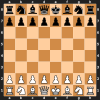

White made move: d2d4



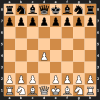

Black made move: g7g6



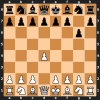

White made move: g1h3



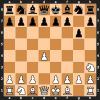

Black made move: d7d5



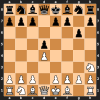

White made move: h3g5



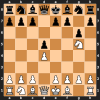

Black made move: b8c6



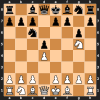

White made move: g5h7



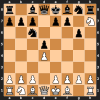

Black made move: f8g7



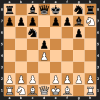

White made move: h7f8



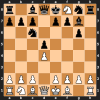

Black made move: c8g4



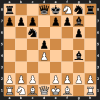

White made move: f8h7



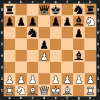

Black made move: g7f8



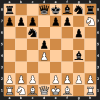

White made move: h7f8



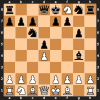

Black made move: a7a5



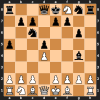

White made move: f8h7



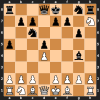

Black made move: a8a7



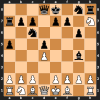

White made move: h7f8



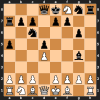

Black made move: h8h3



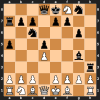

White made move: f8h7



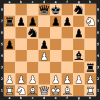

Black made move: h3d3



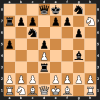

White made move: h7f8



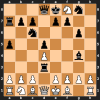

Black made move: g8f6



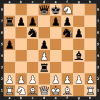

White made move: f8h7



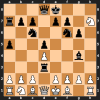

Black made move: b7b6



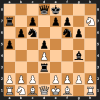

White made move: h7f8



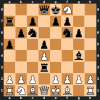

Black made move: d3f3



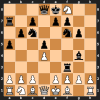

White made move: f8h7



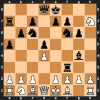

Black made move: b6b5



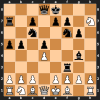

White made move: h7f8



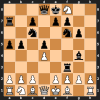

Black made move: d8b8



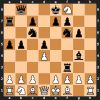

White made move: f8h7



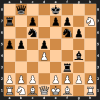

Black made move: f3c3



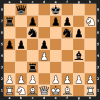

White made move: h7f8



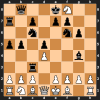

Black made move: c6d4



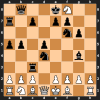

White made move: f8h7



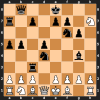

Black made move: e7e5



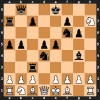

White made move: h7f8



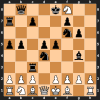

Black made move: e8d8



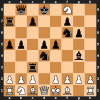

White made move: f8h7



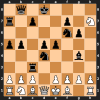

Black made move: d4f5



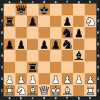

White made move: c1e3



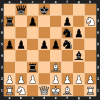

Black made move: c7c5



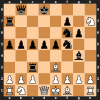

White made move: h7f8



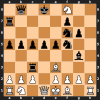

Black made move: a7a6



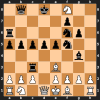

White made move: f8h7



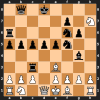

Black made move: c5c4



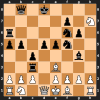

White made move: a2a4



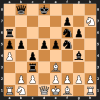

Black made move: d5d4



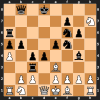

White made move: h7f8



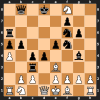

Black made move: g4e2



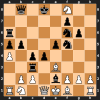

White made move: f8h7



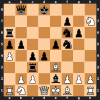

Black made move: f5h4



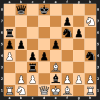

White made move: h7f8



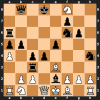

Black made move: c3b3



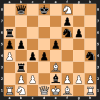

White made move: f8h7



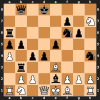

Black made move: h4g2



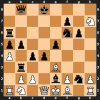

White made move: e1e2



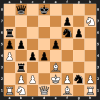

Black made move: g2h4



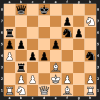

White made move: h7f8



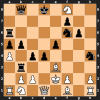

Black made move: f6h5



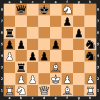

White made move: f8h7



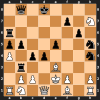

Black made move: b3c3



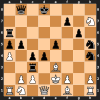

White made move: h7f8



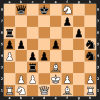

Black made move: h4f3



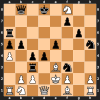

White made move: f8h7



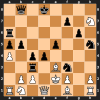

Black made move: f3h2



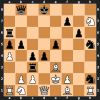

White made move: h7f8



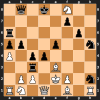

Black made move: b5a4



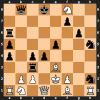

White made move: f8h7



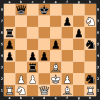

Black made move: a6f6



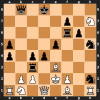

White made move: h7f8



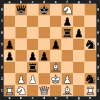

Black made move: b8b3



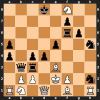

White made move: f8h7



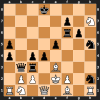

Black made move: f6c6



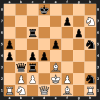

White made move: h7f8



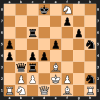

Black made move: c6f6



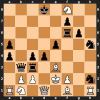

White made move: f8h7



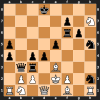

Black made move: b3b5



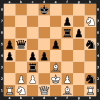

White made move: h7f8



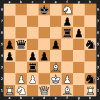

Black made move: b5b3



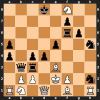

White made move: f8h7



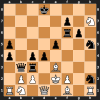

Black made move: h5f4



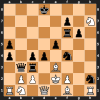

White made move: e2d2



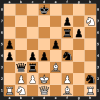

Black made move: f4e2



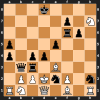

White made move: h7f8



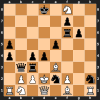

Black made move: e5e4



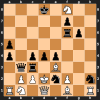

White made move: f8h7



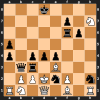

Black made move: f6a6



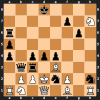

White made move: h7f8



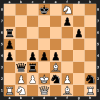

Black made move: f7f6



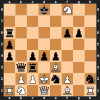

White made move: f8h7



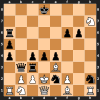

Black made move: g6g5



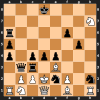

White made move: h7f8



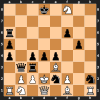

Black made move: h2f3



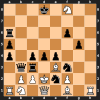

White made move: d2e2



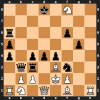

Black made move: f3d2



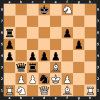

White made move: f8h7



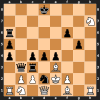

Black made move: b3b7



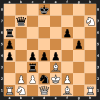

White made move: h7f8



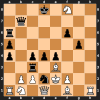

Black made move: c3a3



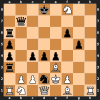

White made move: f8h7



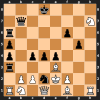

Black made move: b7b2



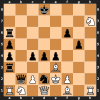

White made move: h7f8



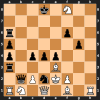

Black made move: a3e3



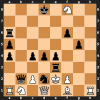

White made move: e2d2



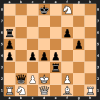

Black made move: d8e8



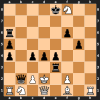

White made move: f8h7



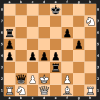

Black made move: b2c1



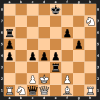

White made move: d2c1



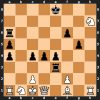

Black made move: e3b3



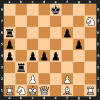

White made move: h7f8



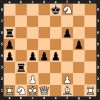

Black made move: b3b7



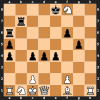

White made move: f8h7



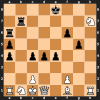

Black made move: a6e6



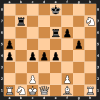

White made move: h7f8



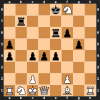

Black made move: b7d7



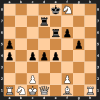

White made move: f8h7



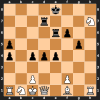

Black made move: f6f5



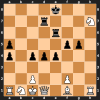

White made move: h7f8



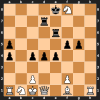

Black made move: d7c7



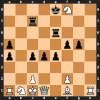

White made move: f8h7



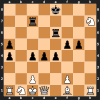

Black made move: e6c6



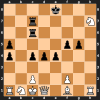

White made move: h7f8



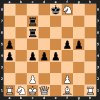

Black made move: g5g4



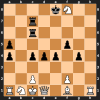

White made move: f8h7



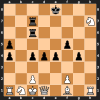

Black made move: c6h6



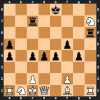

White made move: h7f8



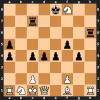

Black made move: h6g6



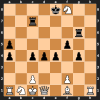

White made move: f8h7



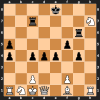

Black made move: g6d6



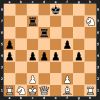

White made move: c1d2



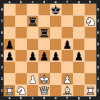

Black made move: d4d3



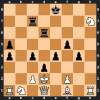

White made move: d2c3



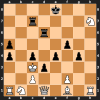

Black made move: c7b7



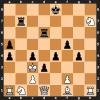

White made move: h7f8



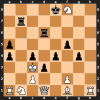

Black made move: e8d8



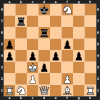

White made move: f8h7



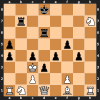

Black made move: b7g7



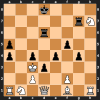

White made move: h7f8



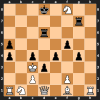

Black made move: d6e6



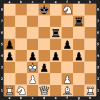

White made move: f2f3



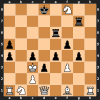

Black made move: d3d2



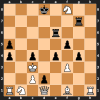

White made move: f8h7



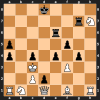

Black made move: g4g3



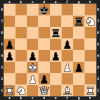

White made move: h7f8



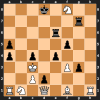

Black made move: a4a3



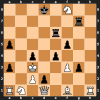

White made move: f8h7



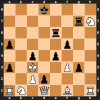

Black made move: g7g5



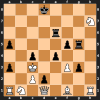

White made move: h7f8



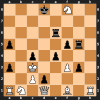

Black made move: f5f4



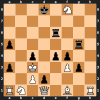

White made move: f8h7



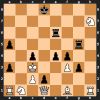

Black made move: g5f5



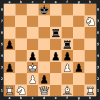

White made move: h7f8



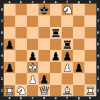

Black made move: g3g2



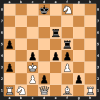

White made move: f8h7



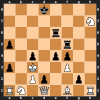

Black made move: d8d7



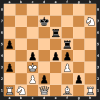

White made move: h7f8



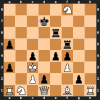

Black made move: d7e7



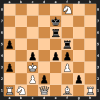

White made move: f8h7



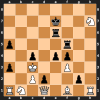

Black made move: e6e5



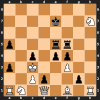

White made move: h7f8



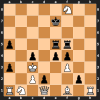

Black made move: g2g1r



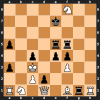

White made move: f8h7



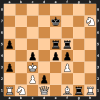

Black made move: e4e3



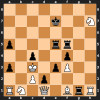

White made move: h7f8



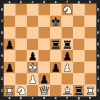

Black made move: e7e8



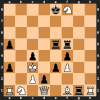

White made move: f8h7



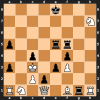

Black made move: e5e4



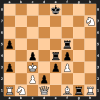

White made move: h7f8



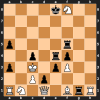

Black made move: g1g8



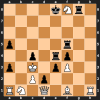

White made move: b1a3



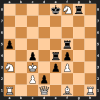

Black made move: e8f7



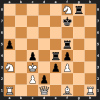

White made move: f8h7



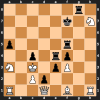

Black made move: e4d4



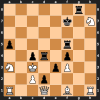

White made move: h7f8



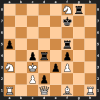

Black made move: f7f8



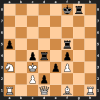

White made move: c3d4



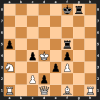

Black made move: g8g3



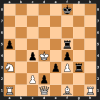

White made move: d4e4



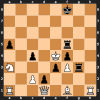

Black made move: f8g7



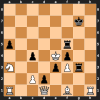

White made move: e4f5



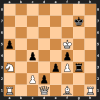

Black made move: g3h3



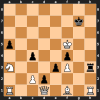

White made move: f5e6



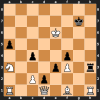

Black made move: h3h8



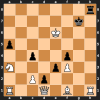

White made move: e6e7



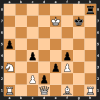

Black made move: h8h4



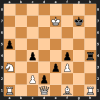

White made move: a3b1



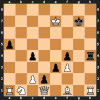

Black made move: g7g8



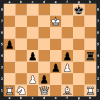

White made move: e7e8



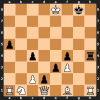

Black made move: g8h7



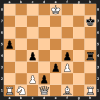

White made move: e8f8



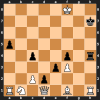

Black made move: c4c3



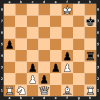

White made move: f8e8



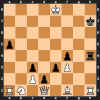

Black made move: h4h6



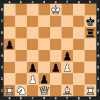

White made move: e8f8



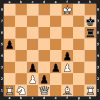

Black made move: h7h8



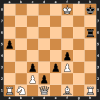

White made move: f8e8



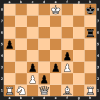

Black made move: h6h1



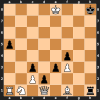

White made move: e8f8



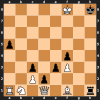

Black made move: h1h2



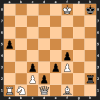

White made move: f8e8



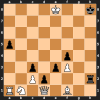

Black made move: h2e2



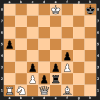

White made move: e8f8



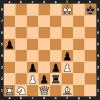

Black made move: h8h7



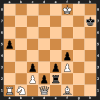

White made move: f8e8



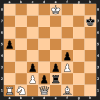

Black made move: h7g8



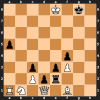

White made move: e8d8



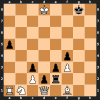

Black made move: g8g7



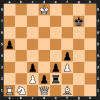

White made move: d8e8



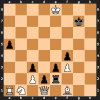

Black made move: g7h7



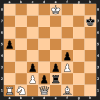

White made move: e8f8



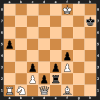

Black made move: e2g2



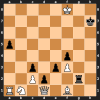

White made move: f8e8



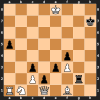

Black made move: g2e2



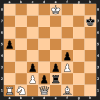

White made move: a1a4



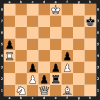

Black made move: h7g7



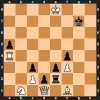

White made move: e8d8



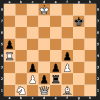

Black made move: g7g6



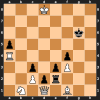

White made move: d8e8



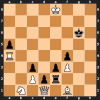

Black made move: g6f5



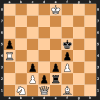

White made move: e8f8



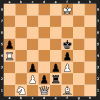

Black made move: f5g6



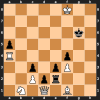

White made move: f8g8



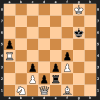

Black made move: g6h5



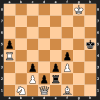

White made move: g8h8



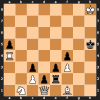

Black made move: e2f2



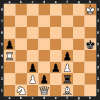

White made move: h8g8



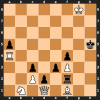

Black made move: h5h4



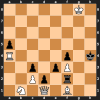

White made move: f1d3



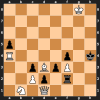

Black made move: e3e2



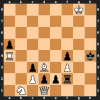

White made move: g8h8



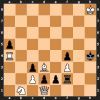

Black made move: f2h2



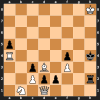

White made move: h8g8



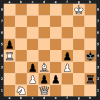

Black made move: e2d1q



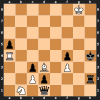

White made move: g8h8



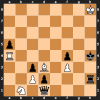

Black made move: h2h1



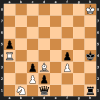

White made move: h8g8



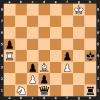

Black made move: h1h3



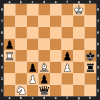

White made move: g8h8



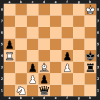

Black made move: d1e2



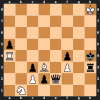

White made move: h8g8



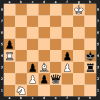

Black made move: e2g2



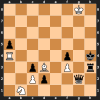

White made move: g8h8



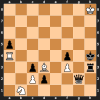

Black made move: h3h2



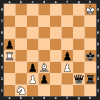

White made move: h8h7



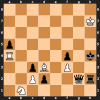

Black made move: g2g4



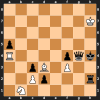

White made move: h7h8



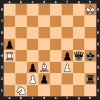

Black made move: g4h5



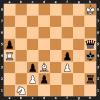

White made move: h8g8



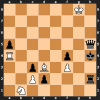

Black made move: h2h1



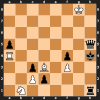

White made move: g8f8



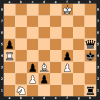

Black made move: h1b1



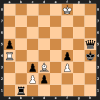

White made move: d3c4



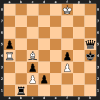

Black made move: b1b8



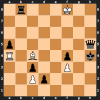

White made move: f8g7



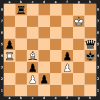

Black made move: b8b2



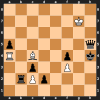

White made move: g7g8



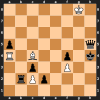

Black made move: h5g4



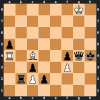

White made move: g8h8



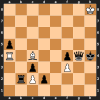

Black made move: g4h5



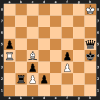

White made move: h8g8



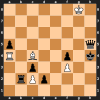

Black made move: h5h6



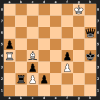

White made move: g8f7



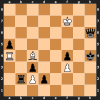

Black made move: h6h8



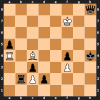

White made move: f7e7



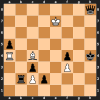

Black made move: h4g5



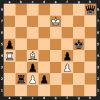

White made move: e7f7



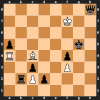

Black made move: b2b3



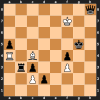

White made move: f7e7



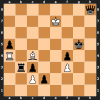

Black made move: h8h7



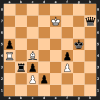

White made move: e7f8



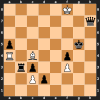

Black made move: h7h1



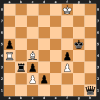

White made move: f8g8



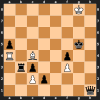

Black made move: h1g2



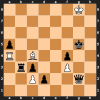

White made move: g8h8



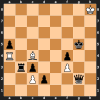

Black made move: d2d1q



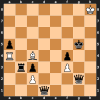

White made move: h8g8



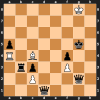

Black made move: d1b1



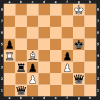

White made move: g8h8



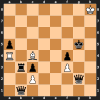

Black made move: g2h2



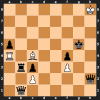

White made move: h8g8



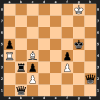

Black made move: b1a2



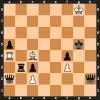

White made move: g8f8



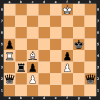

Black made move: a2b2



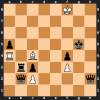

White made move: f8g8



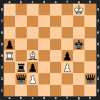

Black made move: h2h8



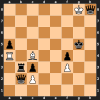

White made move: g8h8



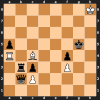

Black made move: b3b8



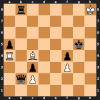

White made move: h8h7



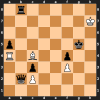

Black made move: g5h4



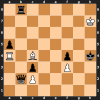

White made move: h7g7



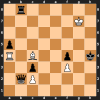

Black made move: b8d8



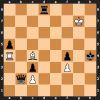

White made move: g7h7



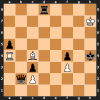

Black made move: b2b6



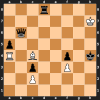

White made move: h7g7



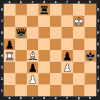

Black made move: d8a8



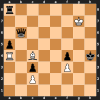

White made move: g7h7



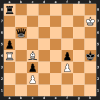

Black made move: b6d8



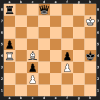

White made move: h7g7



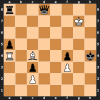

Black made move: d8b8



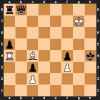

White made move: g7h7



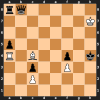

Black made move: b8b7



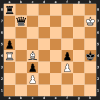

White made move: h7h6



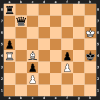

Black made move: b7b2



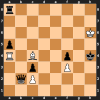

White made move: c4a6



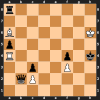

Black made move: a8f8



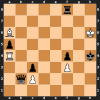

White made move: h6h7



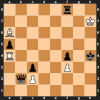

Black made move: b2a3



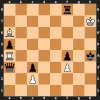

White made move: h7g7



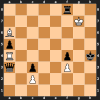

Black made move: f8d8



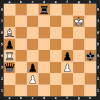

White made move: a4f4



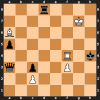

Black made move: h4h5



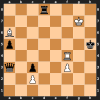

White made move: g7h7



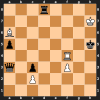

Black made move: d8d6



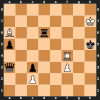

White made move: h7h8



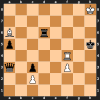

Black made move: a5a4



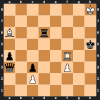

White made move: h8g8



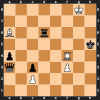

Black made move: h5g6



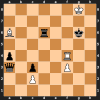

White made move: g8h8



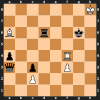

Black made move: g6h5



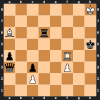

White made move: h8g8



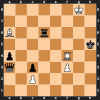

Black made move: a3b2



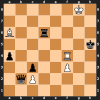

White made move: g8h8



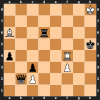

Black made move: b2b6



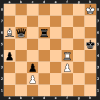

White made move: h8g8



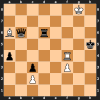

Black made move: b6a6



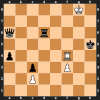

White made move: g8h8



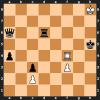

Black made move: a6a5



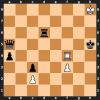

White made move: h8g8



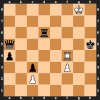

Black made move: d6d2



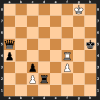

White made move: g8h8



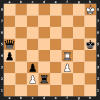

Black made move: d2d5



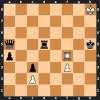

White made move: h8g8



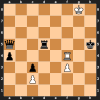

Black made move: h5g5



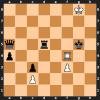

White made move: g8h8



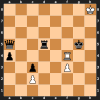

Black made move: d5d2



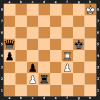

White made move: h8g8



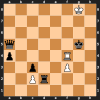

Black made move: a4a3



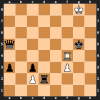

White made move: g8h8



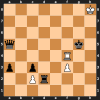

Black made move: g5f4



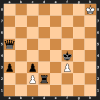

White made move: h8g8



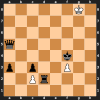

Black made move: a5b4



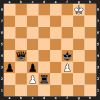

White made move: g8h8



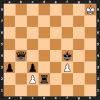

Black made move: d2d7



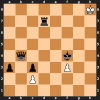

White made move: h8g8



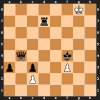

Black made move: f4g5



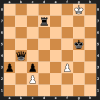

White made move: g8h8



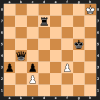

Black made move: d7d6



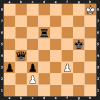

White made move: h8g8



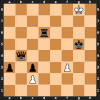

Black made move: d6g6



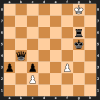

White made move: g8h8



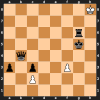

Black made move: b4b3



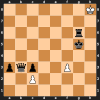

White made move: h8h7



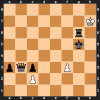

Black made move: g6g7



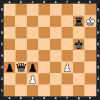

White made move: h7h8



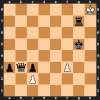

Black made move: g5f4



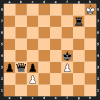

White made move: h8g7



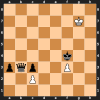

Black made move: f4e5



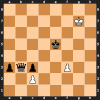

White made move: c2b3



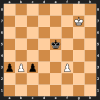

Black made move: e5d5



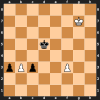

White made move: g7h8



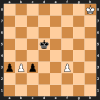

Black made move: d5c5



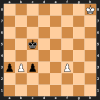

White made move: h8g8



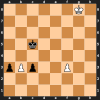

Black made move: c5d5



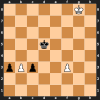

White made move: g8h8



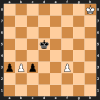

Black made move: d5c6



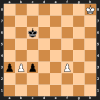

White made move: h8g8



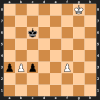

Black made move: c6c7



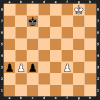

White made move: g8h8



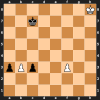

Black made move: c7b8



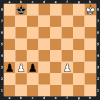

White made move: h8g8



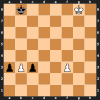

Black made move: b8a8



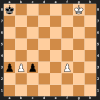

White made move: g8h8



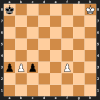

Black made move: a8a7



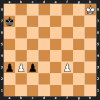

White made move: h8g8



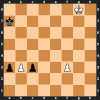

Black made move: a7b7



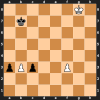

White made move: g8g7



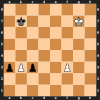

Black made move: b7a6



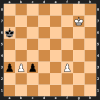

White made move: g7h8



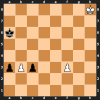

Black made move: a6b5



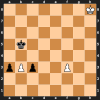

White made move: h8g8



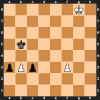

Black made move: b5a5



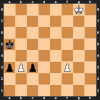

White made move: g8h8



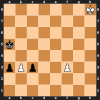

Black made move: a5b5



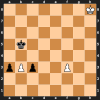

White made move: h8g8



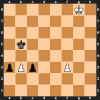

Black made move: b5a5



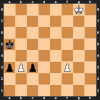

White made move: g8h8



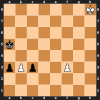

Black made move: a5b5



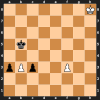

White made move: h8g8



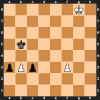

Black made move: b5b4



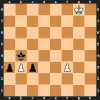

White made move: g8h8



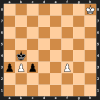

Black made move: b4a5



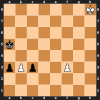

White made move: h8g8



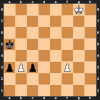

Black made move: a5b6



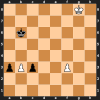

White made move: g8h8



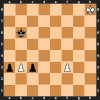

Black made move: b6c6



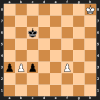

White made move: h8g8



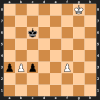

Black made move: c6b6



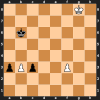

White made move: g8h8



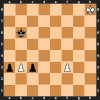

Black made move: a3a2



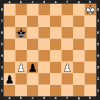

White made move: h8h7



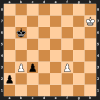

Black made move: b6b5



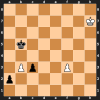

White made move: f3f4



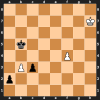

Black made move: c3c2



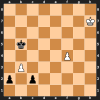

White made move: h7h8



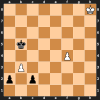

Black made move: b5a6



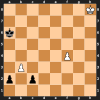

White made move: h8g8



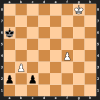

Black made move: a2a1n



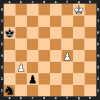

White made move: g8h8



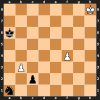

Black made move: c2c1q



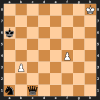

White made move: h8g8



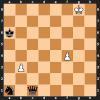

Black made move: c1c2



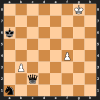

White made move: g8h8



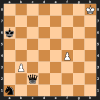

Black made move: c2d3



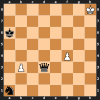

White made move: h8g8



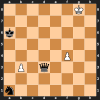

Black made move: d3g3



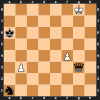

White made move: g8h8



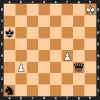

Black made move: a1b3



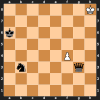

White made move: h8h7



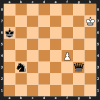

Black made move: g3c3



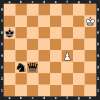

White made move: h7g8



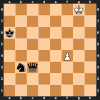

Black made move: b3d2



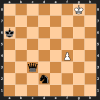

White made move: g8f8



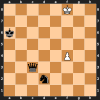

Black made move: c3d4



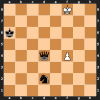

White made move: f8g8



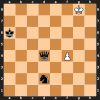

Black made move: d4c5



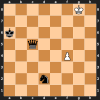

White made move: g8h8



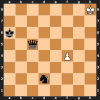

Black made move: c5f8



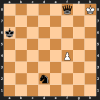

White made move: h8h7



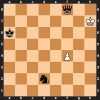

Black made move: a6b5



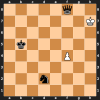

White made move: h7g6



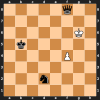

Black made move: b5a6



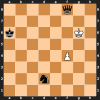

White made move: g6h7



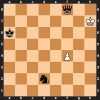

Black made move: d2c4



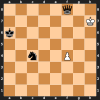

White made move: h7g6



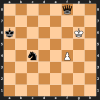

Black made move: f8f5



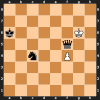

White made move: g6g7



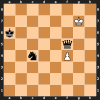

Black made move: c4e3



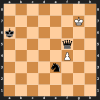

White made move: g7h8



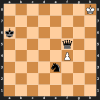

Black made move: f5g5



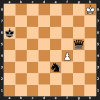

White made move: h8h7



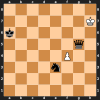

Black made move: a6b7



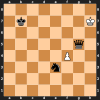

White made move: h7h8



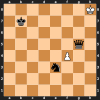

Black made move: b7c8



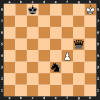

White made move: h8h7



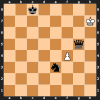

Black made move: g5h4



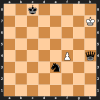

White made move: h7g8



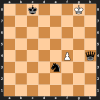

Black made move: h4h6



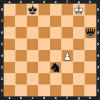

White made move: g8f7



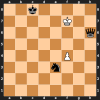

Black made move: h6g7



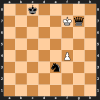

White made move: f7e8



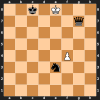

Black made move: g7g6



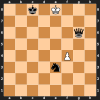

White made move: e8f8



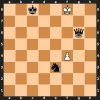

Black made move: c8d8



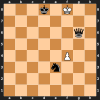

White made move: f4f5



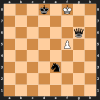

Black made move: e3g4



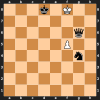

White made move: f5g6



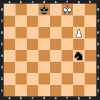

Black made move: g4f6



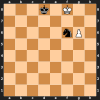

White made move: f8g7



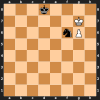

Black made move: d8e8



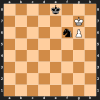

White made move: g7h8



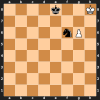

Black made move: e8d7



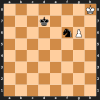

White made move: h8g7



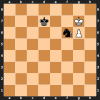

Black made move: d7c7



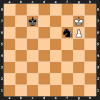

White made move: g7h8



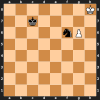

Black made move: c7c6



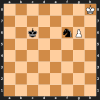

White made move: h8g7



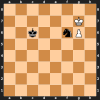

Black made move: c6b6



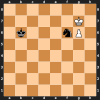

White made move: g7h8



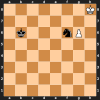

Black made move: f6g4



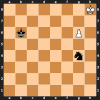

White made move: h8g8



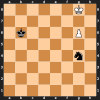

Black made move: b6c6



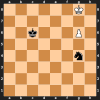

White made move: g8h8



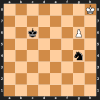

Black made move: c6c5



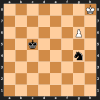

White made move: h8g8



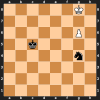

Black made move: c5c6



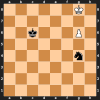

White made move: g8h8



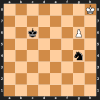

Black made move: g4h6



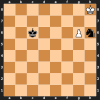

White made move: h8h7



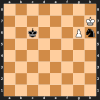

Black made move: c6c7



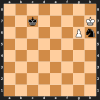

White made move: h7h8



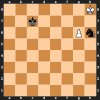

Black made move: c7c6



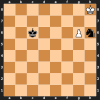

White made move: h8h7



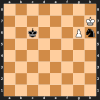

Black made move: c6b7



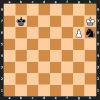

White made move: h7h8



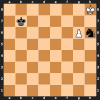

Black made move: b7b8



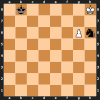

White made move: h8h7



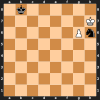

Black made move: h6f7



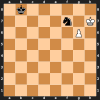

White made move: h7g8



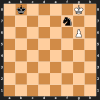

Black made move: f7e5



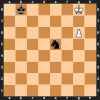

White made move: g8h7



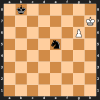

Black made move: e5c4



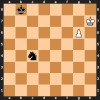

White made move: h7h8



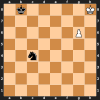

Black made move: c4b2



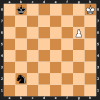

White made move: h8g8



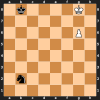

Black made move: b8a7



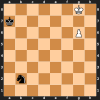

White made move: g6g7



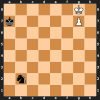

Black made move: b2d1



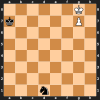

White made move: g8h8



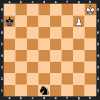

Black made move: a7a8



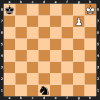

White made move: g7g8q



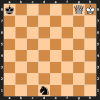

Black made move: a8b7



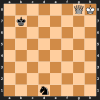

White made move: h8h7



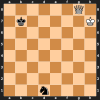

Black made move: d1c3



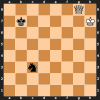

White made move: g8h8



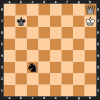

Black made move: c3e4



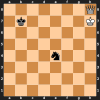

White made move: h8g8



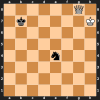

Black made move: e4g5



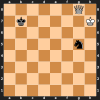

White made move: h7h8



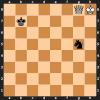

Black made move: b7a7



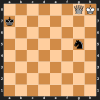

White made move: h8g7



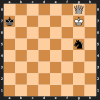

Black made move: g5h3



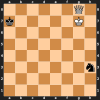

White made move: g8h8



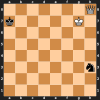

Black made move: a7b7



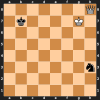

White made move: h8g8



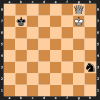

Black made move: b7a6



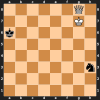

White made move: g8h8



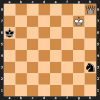

Black made move: h3g1



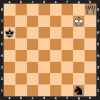

White made move: h8g8



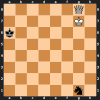

Black made move: g1h3



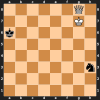

White made move: g8h8



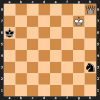

Black made move: h3f4



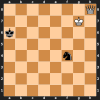

White made move: h8g8



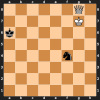

Black made move: f4d5



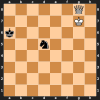

White made move: g8h8



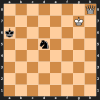

Black made move: d5c3



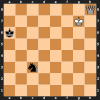

White made move: h8g8



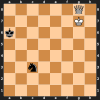

Black made move: a6b5



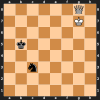

White made move: g8h8



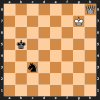

Black made move: c3d5



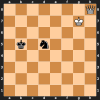

White made move: h8g8



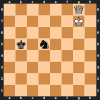

Black made move: d5e7



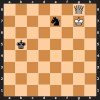

White made move: g8h8



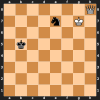

Black made move: b5b4



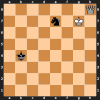

White made move: h8g8



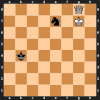

Black made move: e7d5



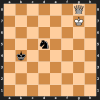

White made move: g8h8



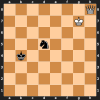

Black made move: d5f6



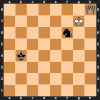

White made move: h8g8



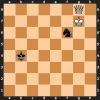

Black made move: f6d5



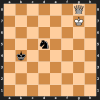

White made move: g8h8



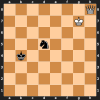

Black made move: b4c5



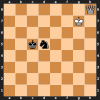

White made move: h8g8



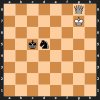

Black made move: c5b6



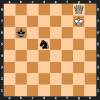

White made move: g8h8



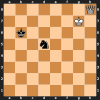

Black made move: b6a6



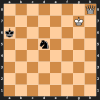

White made move: h8g8



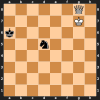

Black made move: d5b4



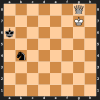

White made move: g8h8



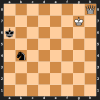

Black made move: b4c2



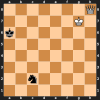

White made move: h8g8



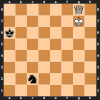

Black made move: a6b5



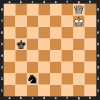

White made move: g8h8



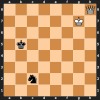

Black made move: b5a5



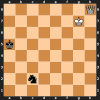

White made move: h8g8



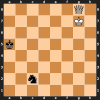

Black made move: c2e3



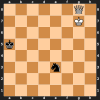

White made move: g8h8



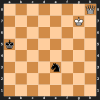

Black made move: e3g2



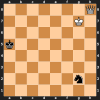

White made move: h8g8



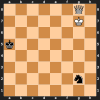

Black made move: a5a6



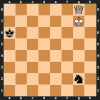

White made move: g8h8



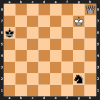

Black made move: g2e3



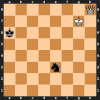

White made move: h8g8



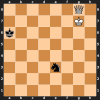

Black made move: a6a5



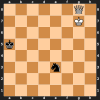

White made move: g8h8



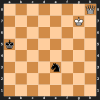

Black made move: e3f1



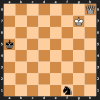

White made move: h8g8



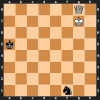

Black made move: a5b6



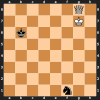

White made move: g8h8



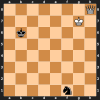

Black made move: f1h2



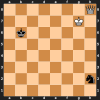

White made move: h8g8



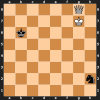

Black made move: b6c7



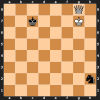

White made move: g8f7



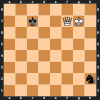

Black made move: c7c8



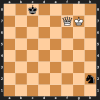

White made move: g7h8



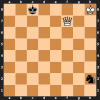

Black made move: h2g4



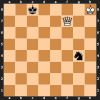

White made move: h8g8



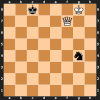

Black made move: g4e3



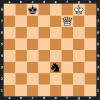

White made move: g8h8



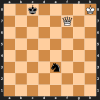

Black made move: c8d8



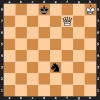

White made move: h8g8



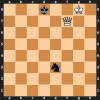

Black made move: e3c2



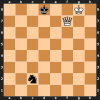

White made move: g8h8



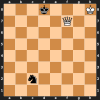

Black made move: c2d4



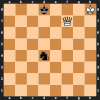

White made move: h8g8



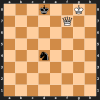

Black made move: d4c2



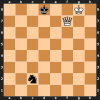

White made move: g8h8



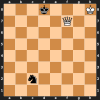

Black made move: c2b4



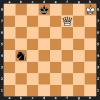

White made move: h8g8



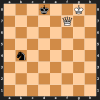

Black made move: b4a2



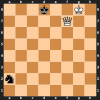

White made move: g8h8



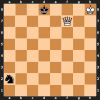

Black made move: a2c3



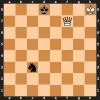

White made move: h8g8



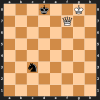

Black made move: d8c8



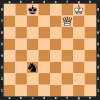

White made move: g8h8



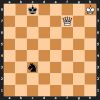

Black made move: c3e2



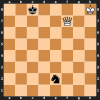

White made move: h8g8



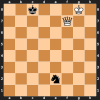

Black made move: e2f4



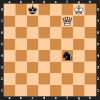

White made move: g8h8



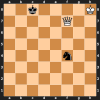

Black made move: f4h3



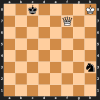

White made move: h8g8



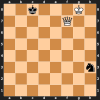

Black made move: h3g1



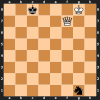

White made move: g8h8



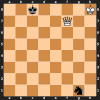

Black made move: c8b8



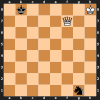

White made move: h8g8



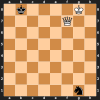

Black made move: g1h3



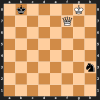

White made move: g8h8



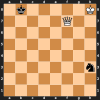

Black made move: b8c8



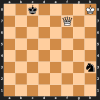

White made move: h8g8



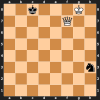

Black made move: c8d8



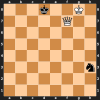

White made move: g8h8



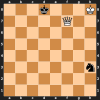

Black made move: d8c8



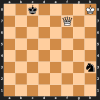

White made move: h8g8



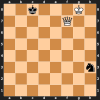

Black made move: h3g5



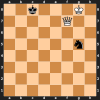

White made move: g8h8



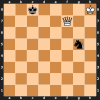

Black made move: g5f7

Game Over! 616 steps
1/2-1/2


In [ ]:
def visualize_game(agent):
    board = chess.Board()
    iter = 0
    while not board.is_game_over():
        iter+=1
        if board.turn == chess.WHITE:
            move = agent.choose_move(board)
        else:
            move = random.choice(list(board.legal_moves))
        display(SVG(chess.svg.board(board=board, size=100)))
        print(f"{chess.COLOR_NAMES[board.turn].capitalize()} made move: {move.uci()}\n")
        board.push(move)
    print(f"Game Over! {iter} steps")
    print(board.result())

visualize_game(agent)

### Улучшение и дальнейшие эксперименты
* Сравнение с другими стратегиями:
* * Простые стратегии:
* * * Агент на основе эвристик: Создайте агента, который выбирает ходы на основе простых эвристических правил, например, предпочтение ходов, которые приводят к поимке вражеских фигур или сохраняют своего короля в безопасности.

* * * Minimax-агент: Это классический алгоритм для игр с двумя игроками. Агент просматривает дерево игры на несколько ходов вперед и выбирает наилучший ход на основе минимаксной оценки.

* * Тестирование:
* * * Играйте множество партий между вашим RL-агентом и каждой из простых стратегий. Регистрируйте результаты и сравнивайте производительность.


---


* Тонкая настройка:
* * Эксплорация vs Эксплуатация:
* * * Настройка параметра ε (эпсилон) в агенте может помочь управлять балансом между исследованием новых ходов и использованием уже известных ходов.
* * Скорость обучения:
* * * Изменяя скорость обучения, вы можете контролировать, насколько быстро агент адаптируется к новой информации.
* * Дисконтный фактор:
* * * Этот параметр определяет, насколько агент заботится о будущих наградах по сравнению с текущими.

---


* Обучение с подкреплением с использованием нейронных сетей: Для улучшения агента можно рассмотреть использование глубокого обучения с подкреплением, где нейронная сеть может приближать Q-значения.
* * Шахматную доску можно представить в виде многоканального изображения, где каждый канал представляет определенную фигуру (например, белые пешки, черные пешки и т. д.).